In [1]:
from neuron import h
from neuron.units import mV, ms
h.load_file('stdrun.hoc')

import matplotlib.pyplot as plt
import plotly.graph_objs as go # for visualizing 3d plots
import plotly.express as px
import plotly

import math
import numpy as np
import tqdm

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
# generate space of initial conditions using one simulation

def run_sim(sim_length = 2000, stim_interval = 10):

    # Set up biophysical model
    axon = h.Section(name='axon')
    axon.insert(h.hh)

    # add a synapse
    syn = h.ExpSyn(axon(0))
    syn.tau = 1 * ms
    syn.e = 0 * mV
    syn_current = h.Vector().record(syn._ref_i)

    # add a stimulus
    stim = h.NetStim()
    stim.number = 9999999
    stim.interval = stim_interval * ms
    stim.noise = True
    stim.start = 0 * ms

    stim_times = h.Vector()

    # connect stimulus to synapse
    nc = h.NetCon(stim, syn)
    nc.delay = 0 * ms
    nc.weight[0] = 0.2
    nc.record(stim_times)

    # setup recording
    _t = h.Vector().record(h._ref_t)
    _v = h.Vector().record(axon(0.5)._ref_v)
    _m = h.Vector().record(axon(0.5).hh._ref_m)
    _n = h.Vector().record(axon(0.5).hh._ref_n)
    _h = h.Vector().record(axon(0.5).hh._ref_h)
    spike_times = h.Vector()
    nc_self = h.NetCon(axon(0.5)._ref_v, None, sec=axon)
    nc_self.record(spike_times)

    # run simulation
    h.finitialize(-65 * mV)
    h.continuerun(sim_length * ms)

    return _t, np.array((_v, _m, _h, _n)), stim_times

sim_params = ['v','m','h','n']

In [4]:
time, sim_df, stim_times = run_sim()

In [5]:
# 3d plot over n, h, and m

# Configure the trace.
trace = go.Scatter3d(
    x = sim_df[1,:], # m
    y = sim_df[2,:], # h
    z = sim_df[3,:], # n
    mode='markers',
    marker={
        'size': 2,
        'opacity': 0.5,
        'color':sim_df[0,:], # V
        'colorscale':px.colors.sequential.Viridis,
        'showscale':True
    }
)

# Configure the layout.
layout = go.Layout(
    margin={'l': 0, 'r': 0, 'b': 0, 't': 0},
    scene = dict(
        xaxis_title='m',
        yaxis_title='h',
        zaxis_title='n'
    )
)

data = [trace]
plot_figure = go.Figure(data=data, layout=layout)

# Render the plot.
plotly.offline.iplot(plot_figure)

## Normalize data

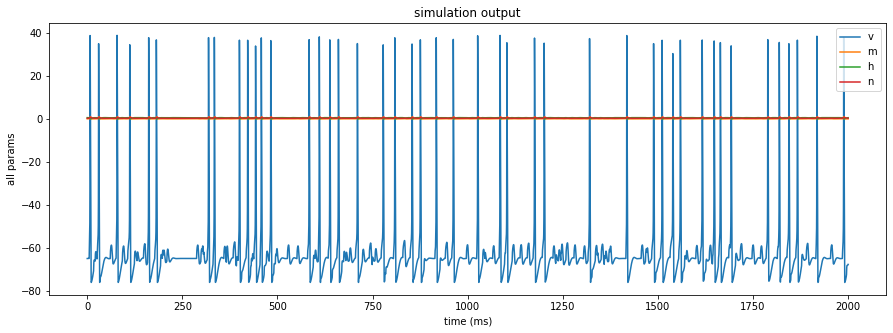

In [6]:
plt.figure(figsize=(15,5))
plt.plot(time, sim_df[0,:])
plt.plot(time, sim_df[1,:])
plt.plot(time, sim_df[2,:])
plt.plot(time, sim_df[3,:])
plt.legend(sim_params)
plt.title('simulation output')
plt.ylabel('all params')
plt.xlabel('time (ms)')
plt.show()

In [7]:
def normalize_sim_df(df):
    # normalize each dimension of the simulation data to fit in range [-1,1]
    biases = []
    scalars = []
    
    sim_df_norm = np.zeros(df.shape)
    
    for dim in range(df.shape[0]):
        bias = np.mean((np.min(df[dim,:]), np.max(df[dim,:])))
        biases.append(bias)
        scalar = -(np.min(df[dim,:]) - np.max(df[dim,:]))/2
        scalars.append(scalar)
        
        sim_df_norm[dim,:] = (df[dim,:] - bias)/scalar
    
    return sim_df_norm, biases, scalars

sim_df_norm, biases, scalars = normalize_sim_df(sim_df)

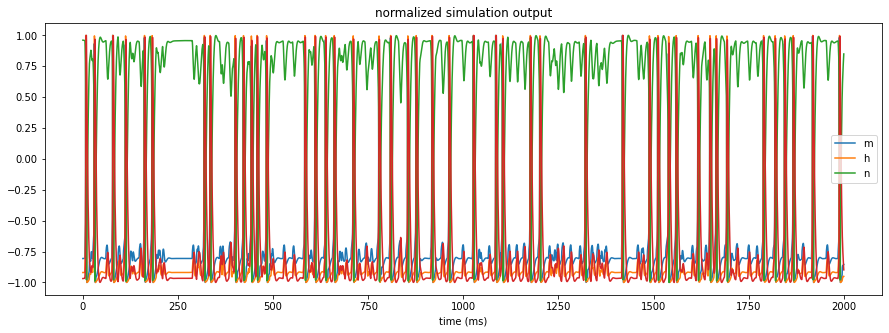

In [8]:
plt.figure(figsize=(15,5))
plt.plot(time, sim_df_norm[0,:])
plt.plot(time, sim_df_norm[1,:])
plt.plot(time, sim_df_norm[2,:])
plt.plot(time, sim_df_norm[3,:])
plt.legend(sim_params[1:])
plt.xlabel('time (ms)')
plt.title('normalized simulation output')
plt.show()

In [9]:
def denormalize_sim_df(norm_df, biases, scalars):
    # reverse of normalize_sim_df()
    sim_df_denorm = np.zeros(norm_df.shape)
    
    for dim in range(norm_df.shape[0]):
        sim_df_denorm[dim,:] = (norm_df[dim,:]*scalars[dim]) + biases[dim]
    
    return sim_df_denorm

sim_df_denorm = denormalize_sim_df(sim_df_norm, biases, scalars)

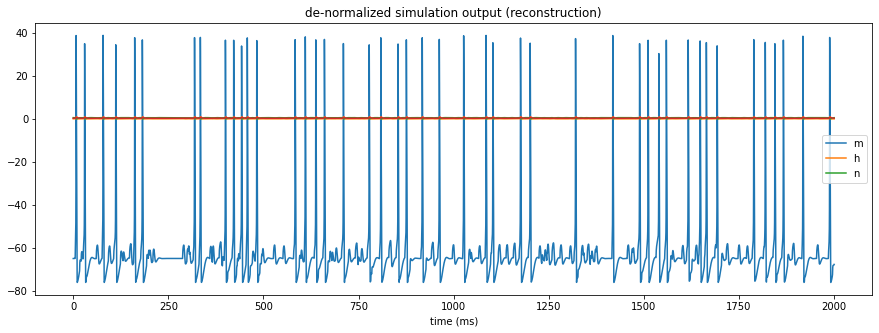

In [10]:
plt.figure(figsize=(15,5))
plt.plot(time, sim_df_denorm[0,:])
plt.plot(time, sim_df_denorm[1,:])
plt.plot(time, sim_df_denorm[2,:])
plt.plot(time, sim_df_denorm[3,:])
plt.legend(sim_params[1:])
plt.xlabel('time (ms)')
plt.title('de-normalized simulation output (reconstruction)')
plt.show()

## Voxelation

In [11]:
from collections import defaultdict
import random

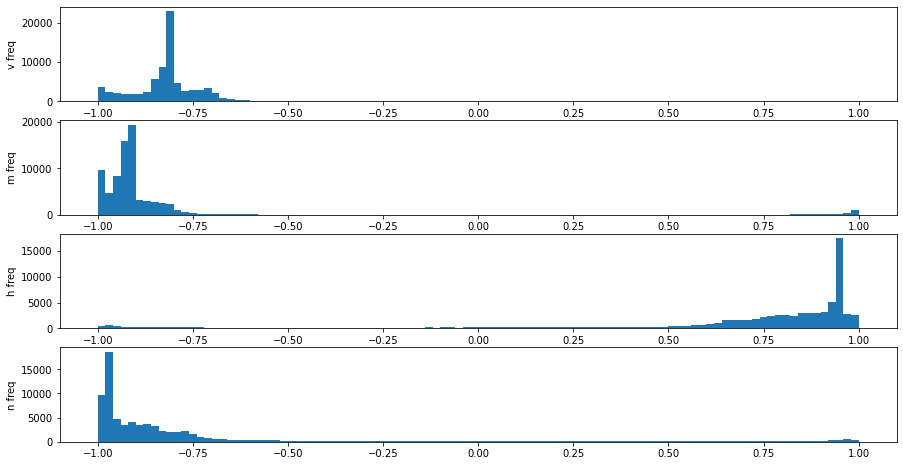

In [12]:
data = sim_df_norm

fig, axes = plt.subplots(len(sim_df_norm),1, figsize=(15,8))

for i in range(len(sim_params)):
    axes[i].hist(data[i,:], bins=100)
    axes[i].set_ylabel(sim_params[i] + ' freq')

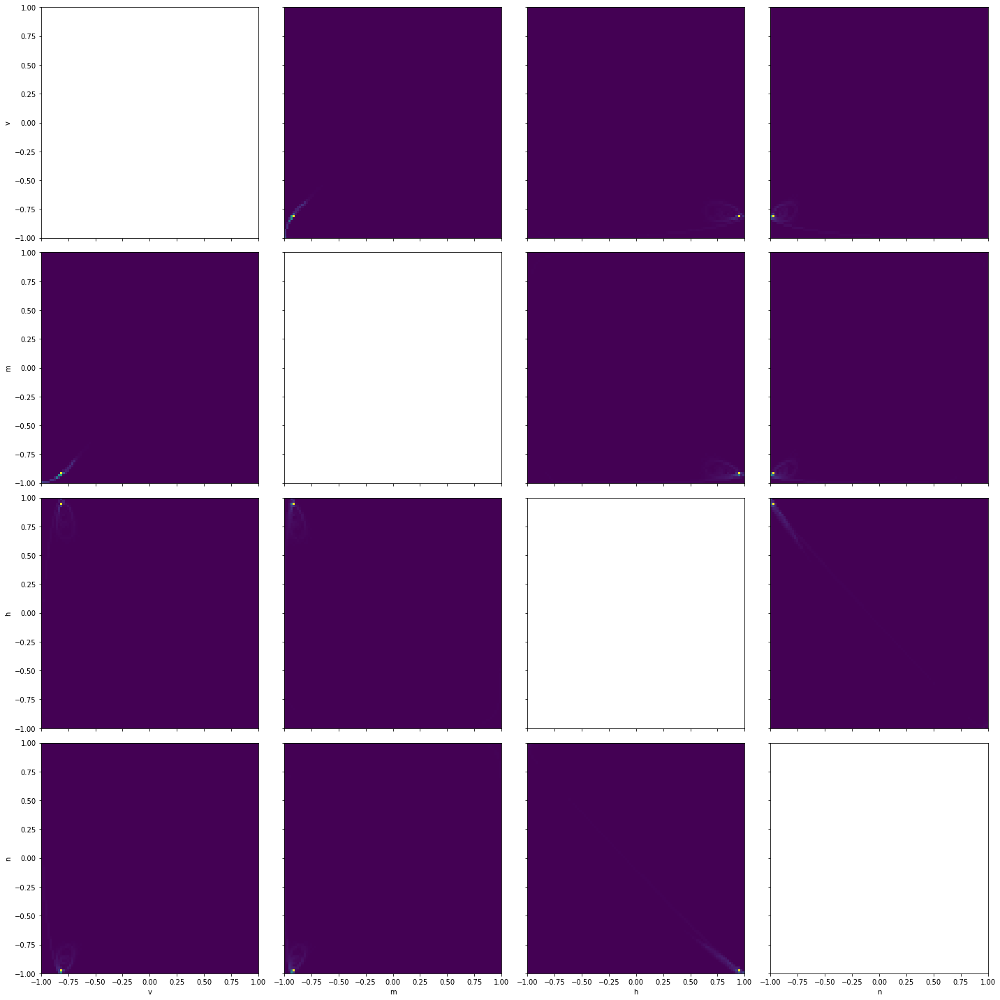

In [14]:
data = sim_df_norm

fig, axes = plt.subplots(len(sim_params), len(sim_params), figsize=(20,20), 
                         sharex='col', sharey='row')

for i, param1 in enumerate(sim_params):   
    for j, param2 in enumerate(sim_params):
        if i != j:
            axes[i,j].hist2d(data[j,:], data[i,:], bins = (100, 100))
        if i == len(sim_params) -1:
            axes[i,j].set_xlabel(sim_params[j])
        if j == 0:
            axes[i,j].set_ylabel(sim_params[i])
            
fig.tight_layout()
plt.show()

In [17]:
def voxelate(df, voxels_per_dimension, n_points_per_voxel = 1):
    # df: data to voxelate of shape (n_dims, n_obvs)
    # voxels_per_dimension: list of number of voxels per dimension of len n_dims
    n_dims = len(voxels_per_dimension)
    n_obvs = df.shape[1]
    
    # generate voxel bins for each dimension
    voxels = []
    for i in range(n_dims):
        dim_min = min(df[i,:])
        dim_max = max(df[i,:])
        
        # add roughly 1 buffer voxel to either end
        buffer_voxel_len = (dim_max - dim_min)/voxels_per_dimension[i]
        dim_min = dim_min - buffer_voxel_len
        dim_max = dim_max + buffer_voxel_len
        
        # create dim_voxels
        dim_voxels = np.linspace(start = dim_min, stop = dim_max, num = voxels_per_dimension[i])
        
        voxels.append(dim_voxels)
        
    # digitize data
    digitized_df = []
    for i in range(n_dims):
        digitized_df.append(np.digitize(df[i,:], voxels[i], right=True))
    digitized_df = np.vstack(digitized_df)
    
    # use a defaultdict to store occupied voxels and thier points
    occupied_voxels = defaultdict(list)
    
    for j in range(n_obvs):
        #print(digitized_df[:,j])
        voxel_hash = [str(x) for x in list(digitized_df[:,j])]
        voxel_hash = '_'.join(voxel_hash)
        occupied_voxels[voxel_hash].append(j)
        
    # choose n_points_per_voxel random point(s) from each voxel 
    #TODO: this method should be tested agaisnt other methods
    sampled_points = []
    point_inds = []
    density_measure = []
    for voxel in occupied_voxels:
        obvs = random.sample(occupied_voxels[voxel], k = min(n_points_per_voxel, len(occupied_voxels[voxel])))
        for obv in obvs:
            sampled_points.append(df[:,obv])
            point_inds.append(obv)
            density_measure.append(len(occupied_voxels[voxel]))
    sampled_points = np.vstack(sampled_points)
    
    return sampled_points.T, point_inds, density_measure
    
sampled_points, point_inds, density_measure = voxelate(sim_df_norm, [100,100,100,100])

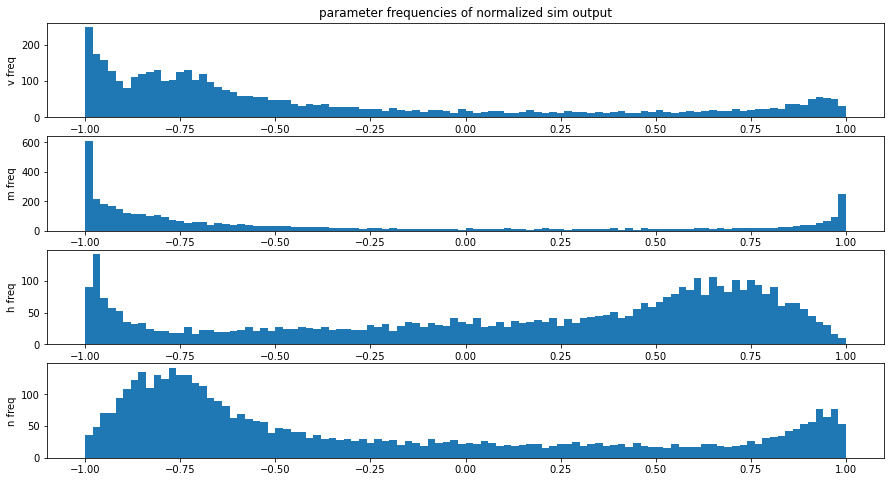

In [19]:
data = sampled_points

fig, axes = plt.subplots(len(sim_params),1, figsize=(15,8))

axes[0].set_title('parameter frequencies of normalized sim output')

for i in range(len(sim_params)):
    axes[i].hist(data[i,:], bins=100)
    axes[i].set_ylabel(sim_params[i] + ' freq')

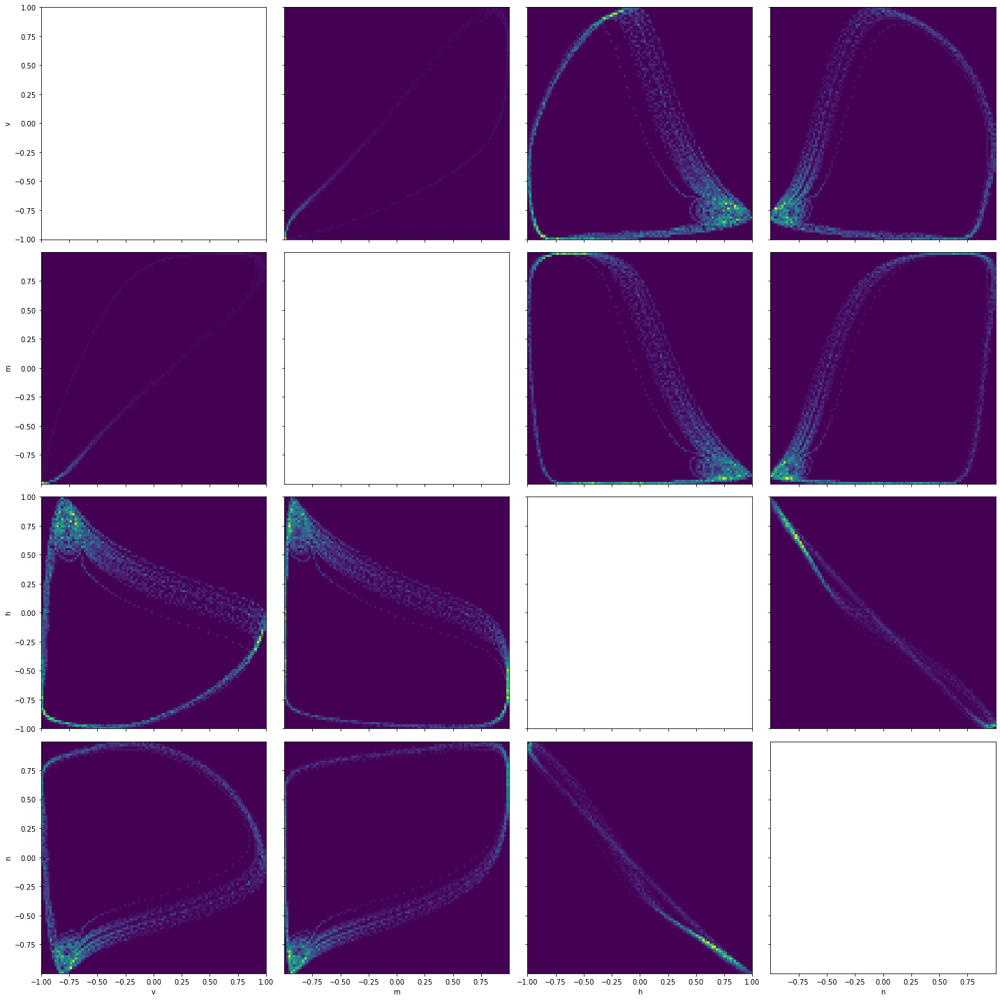

In [20]:
data = sampled_points

fig, axes = plt.subplots(len(sim_params), len(sim_params), figsize=(20,20),
                         sharex='col', sharey='row')

for i, param1 in enumerate(sim_params):   
    for j, param2 in enumerate(sim_params):
        if i != j:
            axes[i,j].hist2d(data[j,:], data[i,:], bins = (100, 100))
        if i == len(sim_params) -1:
            axes[i,j].set_xlabel(sim_params[j])
        if j == 0:
            axes[i,j].set_ylabel(sim_params[i])
            
fig.tight_layout()
plt.show()

## Diffusion Maps

In [21]:
# generate gaussian kernel matrix
from scipy.spatial.distance import pdist, squareform

def calc_kernel(W, alpha):
    # pairwise dists
    pairwise_dists = squareform(pdist(W, 'euclidean'))
    # kernel function
    K = np.exp(-pairwise_dists ** 2 / alpha)
    return K

def calc_p_prime(K):
    r = np.sum(K, axis=0)
    Di = np.diag(1/r)

    # diffusion matrix
    P = np.matmul(Di, K)

    D_right = np.diag((r)**0.5)

    # D^(-1/2) matrix
    D_left = np.diag((r)**-0.5)

    # symmetrized diffusion matrix P
    P_prime = np.matmul(D_right, np.matmul(P,D_left))
    
    return P_prime, D_left

def eigen_decomp(P_prime):
    # eigenvalue decomposition
    eigVals, eigVecs = np.linalg.eig(P_prime)
    
    return eigVals, eigVecs

def diffusion_map(eigVals, eigVecs, D_left, n_dims):
    # sort by eigenVals
    idx = eigVals.argsort()[::-1]
    eigVals_sorted = eigVals[idx]
    eigVecs_sorted = eigVecs[:,idx]

    diffusion_coordinates = np.matmul(D_left, eigVecs_sorted)

    #diffusion_map = diffusion_coordinates[:,:n_dims]
    diffusion_map = diffusion_coordinates
    
    return diffusion_map, eigVals_sorted

In [22]:
# run diffusion maps on sampled points
alpha = 0.15
n_dims = 3

K = calc_kernel(sampled_points.T, alpha)
P_prime, D_left = calc_p_prime(K)
eigVals, eigVecs = eigen_decomp(P_prime)
dm, eigVals_sorted = diffusion_map(eigVals, eigVecs, D_left, n_dims)

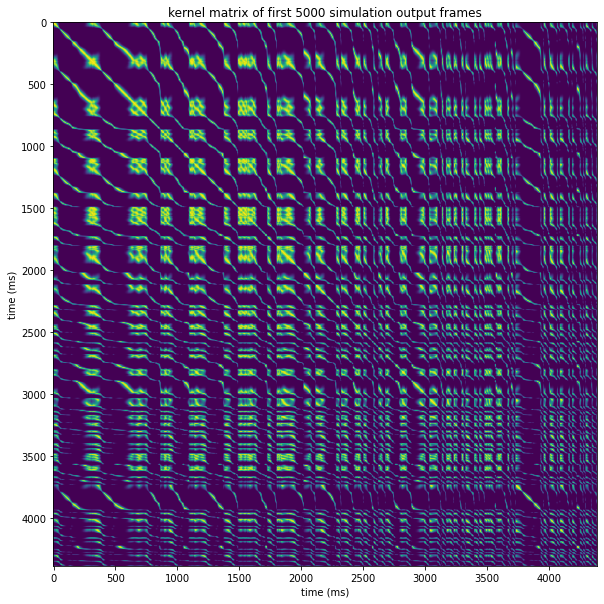

In [23]:
# kernel matrix visualized
plt.figure(figsize=(10,10))
plt.imshow(K)
plt.title('kernel matrix of first 5000 simulation output frames')
plt.xlabel('time (ms)') # TODO: this is a lie, this is frames not ms
plt.ylabel('time (ms)') # TODO: this is a lie, this is frames not ms
plt.show()

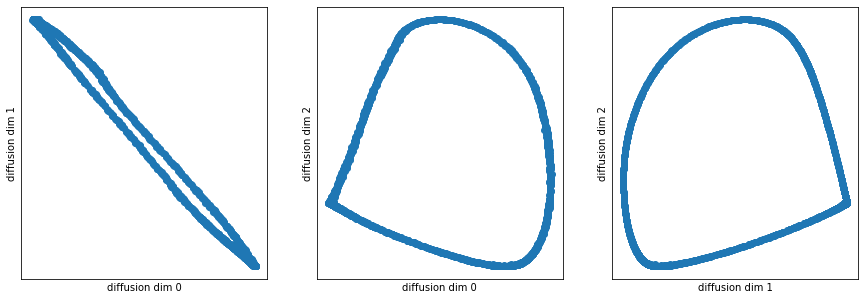

In [24]:
plt.figure(figsize=(15,5))

plt.subplot(131)
plt.scatter(dm[:,0], dm[:,1])
plt.xlabel('diffusion dim 0')
plt.ylabel('diffusion dim 1')
plt.xticks([])
plt.yticks([])

plt.subplot(132)
plt.scatter(dm[:,0], dm[:,2])
plt.xlabel('diffusion dim 0')
plt.ylabel('diffusion dim 2')
plt.xticks([])
plt.yticks([])

plt.subplot(133)
plt.scatter(dm[:,1], dm[:,2])
plt.xlabel('diffusion dim 1')
plt.ylabel('diffusion dim 2')
plt.xticks([])
plt.yticks([])

plt.show()

In [25]:
_dm = dm.real
_dm = _dm / (1/ np.max(_dm))
_dm = np.round(_dm, 10)

In [26]:
# 3d plot over n, h, and m

import plotly.express as px
# Configure the trace.
trace = go.Scatter3d(
    x = _dm[:,0], # m
    y = _dm[:,1], # h
    z = _dm[:,2], # n
    mode='markers',
    marker={
        'size': 2,
        'opacity': 0.5,
        'color':[min(_d, 10000000) for _d in density_measure], 
        'showscale':True
    }
)

# Configure the layout.
layout = go.Layout(
    margin={'l': 0, 'r': 0, 'b': 0, 't': 0},
    scene = dict(
        xaxis_title='dm1',
        yaxis_title='dm2',
        zaxis_title='dm3'
    )
)

data = [trace]
plot_figure = go.Figure(data=data, layout=layout)

# Render the plot.
plotly.offline.iplot(plot_figure)